In [1]:
import numpy as np
import pandas as pd
import leidenalg

import scipy.sparse as sparse
from scipy.io import mmread
from scipy.stats import pearsonr, pointbiserialr

from anndata import AnnData
import anndata

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.lines import Line2D

import seaborn as sns

import scanpy as sc
sc.logging.print_header()

sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 1 # errors (0), warnings (1), info (2), hints (3)

import warnings
warnings.filterwarnings("ignore") 

sns.set_style("white")
np.random.seed(0)

import os, re
import pprint
from IPython.display import display

from utils.util_data import *

scanpy==1.8.1 anndata==0.7.6 umap==0.5.1 numpy==1.20.1 scipy==1.6.2 pandas==1.2.4 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.9.1 pynndescent==0.5.4


## Load Slide-seq Dataset
Allocate path to folder and the file name of the designated AnnaData Object (in `.h5ad` format) <br>

In [2]:
# Define File paths
file_path = os.path.join("data", "slide_seq", "v2")
gcm_filename = "Cerebellum_MappedDGEForR.csv"

# (Optional) Arguments for load_data only if annadata is not present
locations_filename = "Cerebellum_BeadLocationsForR.csv"
adata_filename = "slideseqv2_cerebellum_adataraw.h5ad"

### Loading anndata file or converting raw files to anndata format  (h5ad)

If the specified anndata file is present in the directory, the annadata file `.h5ad` in the file path can be read directly by setting the `load_adata_directly` to `True` <br>
Otherwise, `load_data` can convert the raw data of GCM and locations in `.csv` format to `.h5ad` directly if Annadata file is not present

In [3]:
from utils.load_data import load_adata, display_adata

# To either load data from .h5ad directly or convert raw data to .h5ad format
load_adata_directly = True

# Keys to specify coordinate indexes in the anndata Object
coord_keys = ('xcoord', 'ycoord', 'coord_xy')

raw_y, raw_x, raw_adata = load_adata(file_path,
                                     load_adata_directly, 
                                     adata_filename, 
                                     gcm_filename, 
                                     locations_filename,
                                     coord_keys)

Looking for data\slide_seq\v2\slideseqv2_cerebellum_adataraw.h5ad
Attemping to read Annadata directly
Anndata file successfully loaded!


### Display Anndata Object
Use `display_adata` to show summary of anndata object

In [4]:
display_adata(raw_adata)

Displaying adata Object and their attributes
Adata attributes and dimensions:


AnnData object with n_obs × n_vars = 39496 × 23096
    obs: 'xcoord', 'ycoord'
    obsm: 'coord_xy'

Matrix sparsity: 10028445 filled elements (0.01) out of 912199616
max: 455.0, min: 1.0

Displaying observations (adata.obs)


,xcoord,ycoord
barcodes,,
CTTCCATGACATTT,2892.276596,3060.489362
TAGCCGGGTCTCTG,5459.803030,4279.257576
GCCTTGCTGAGCTC,1632.575000,3463.375000
AGATACCAAGCCTT,3718.147059,3273.235294
TGAAACGTGTCATT,3733.886364,5466.000000
...,...,...
GACTCGAGCAAAAA,4214.606061,2584.696970
TCTACAAGCAAAAC,4079.536082,4734.577320
AAAAATAAAAAAAA,1279.972973,376.756757


Displaying variables (adata.var)


""
Row
0610005C13Rik
0610007P14Rik
0610009B22Rik
0610009E02Rik
0610009L18Rik
...
mt-Tv
n-R5-8s1
n-R5s173


### Preprocess AnnData Object 
We then preprocess the raw adata file with `preprocess_data`, which calculates the QC metrics using `scanpy`'s built-in function `sc.pp.calculate_qc_metrics` and adding them in-place in the anndata object

In [5]:
from utils.preprocessing import preprocess_data

adata = preprocess_data(raw_adata)

### Display the preprocessed adata with added qc_metrics

Now the anndata contains qc_metric under its variables (`adata.var`)

In [6]:
display(adata.obs, adata.var)

,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt
barcodes,,,,,,,,,,,,,
CTTCCATGACATTT,2892.276596,3060.489362,188,5.241747,245.0,5.505332,43.673469,64.081633,100.000000,100.000000,0.0,0.0,0.0
TAGCCGGGTCTCTG,5459.803030,4279.257576,143,4.969813,160.0,5.081404,41.875000,73.125000,100.000000,100.000000,0.0,0.0,0.0
GCCTTGCTGAGCTC,1632.575000,3463.375000,539,6.291569,702.0,6.555357,26.353276,37.464387,51.709402,94.444444,0.0,0.0,0.0
AGATACCAAGCCTT,3718.147059,3273.235294,364,5.899897,441.0,6.091310,28.798186,40.136054,62.811791,100.000000,0.0,0.0,0.0
TGAAACGTGTCATT,3733.886364,5466.000000,1028,6.936343,1499.0,7.313221,22.615077,30.887258,44.229486,64.776518,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
GACTCGAGCAAAAA,4214.606061,2584.696970,53,3.988984,59.0,4.094345,94.915254,100.000000,100.000000,100.000000,0.0,0.0,0.0
TCTACAAGCAAAAC,4079.536082,4734.577320,43,3.784190,46.0,3.850147,100.000000,100.000000,100.000000,100.000000,0.0,0.0,0.0
AAAAATAAAAAAAA,1279.972973,376.756757,21,3.091042,22.0,3.135494,100.000000,100.000000,100.000000,100.000000,0.0,0.0,0.0


,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
Row,,,,,,,
0610005C13Rik,False,1,0.000025,0.000025,99.997468,1.0,0.693147
0610007P14Rik,False,679,0.018888,0.018712,98.280839,746.0,6.616065
0610009B22Rik,False,433,0.011672,0.011604,98.903686,461.0,6.135565
0610009E02Rik,False,33,0.000836,0.000835,99.916447,33.0,3.526361
0610009L18Rik,False,173,0.004608,0.004597,99.561981,182.0,5.209486
...,...,...,...,...,...,...,...
mt-Tv,False,160,0.004051,0.004043,99.594896,160.0,5.081404
n-R5-8s1,False,23,0.000582,0.000582,99.941766,23.0,3.178054
n-R5s173,False,1,0.000025,0.000025,99.997468,1.0,0.693147


## Visualize the histogram plot of `total_counts` and `n_genes`
We can visualize the unfiltered and filtered histograms for `total_counts` and `n_genes` variables in the adata object <br> 

The filtered histograms are plotted after filtering by the upper threshold of total counts `total_counts_cuttoff`, the upper threshold of n_genes `n_genes_high_cutoff`, and the lower threshold of n_genes

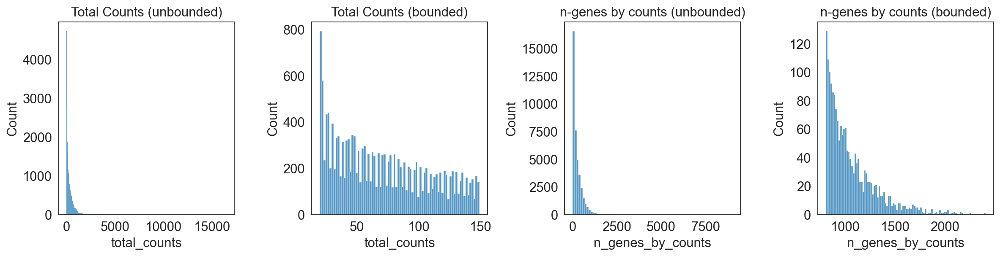

In [7]:
from utils.plot_utils import plot_qc_hist, plot_cell_positions

# bin options for fomratting histograms
# Here, we set 'auto' for 1st figure, 80 bins for 2nd figure. and so on
hist_bin_options = ['auto', 80, 80, 100]

plot_qc_hist(adata, 
         total_counts_cutoff=150, 
         n_genes_high_cutoff=2500, 
         n_genes_low_cutoff=800,
         bin_options = hist_bin_options)

## Do an initial filter of cells by their cell counts, MT count and gene counts
We can then first filter cells by their counts, MT and gene filters.

In [8]:
from utils.filter_utils import filter_cells

# Filter cells with each respective filters
adata = filter_cells(adata, 
             min_count=50, 
             max_count=2500, 
             MT_filter=20, 
             gene_filter=10)

Cells before filtering: 39496



Trying to set attribute `.var` of view, copying.


Cells after count filter: 33300

cells after MT filter: 33300

Genes after minimum cells per gene filter: 16039



Show summary of adata after filtering by cell counts

In [9]:
display_adata(raw_adata)

Displaying adata Object and their attributes
Adata attributes and dimensions:


AnnData object with n_obs × n_vars = 33300 × 23096
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    obsm: 'coord_xy'

Matrix sparsity: 9677371 filled elements (0.01) out of 769096800
max: 455.0, min: 1.0

Displaying observations (adata.obs)


,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_counts
barcodes,,,,,,,,,,,,,,
CTTCCATGACATTT,2892.276596,3060.489362,188,5.241747,245.0,5.505332,43.673469,64.081633,100.000000,100.000000,0.0,0.0,0.0,245.0
TAGCCGGGTCTCTG,5459.803030,4279.257576,143,4.969813,160.0,5.081404,41.875000,73.125000,100.000000,100.000000,0.0,0.0,0.0,160.0
GCCTTGCTGAGCTC,1632.575000,3463.375000,539,6.291569,702.0,6.555357,26.353276,37.464387,51.709402,94.444444,0.0,0.0,0.0,702.0
AGATACCAAGCCTT,3718.147059,3273.235294,364,5.899897,441.0,6.091310,28.798186,40.136054,62.811791,100.000000,0.0,0.0,0.0,441.0
TGAAACGTGTCATT,3733.886364,5466.000000,1028,6.936343,1499.0,7.313221,22.615077,30.887258,44.229486,64.776518,0.0,0.0,0.0,1499.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTTTCAAGAAACA,4340.000000,3312.261364,101,4.624973,106.0,4.672829,51.886792,99.056604,100.000000,100.000000,0.0,0.0,0.0,106.0
AGGGTAACGAAAAC,5016.590909,2432.984848,130,4.875197,141.0,4.955827,43.262411,78.723404,100.000000,100.000000,0.0,0.0,0.0,141.0
TTGCCCGTCAAACA,4602.906977,3682.116279,147,4.997212,197.0,5.288267,50.761421,76.142132,100.000000,100.000000,0.0,0.0,0.0,197.0


Displaying variables (adata.var)


,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
Row,,,,,,,
0610005C13Rik,False,1,0.000025,0.000025,99.997468,1.0,0.693147
0610007P14Rik,False,679,0.018888,0.018712,98.280839,746.0,6.616065
0610009B22Rik,False,433,0.011672,0.011604,98.903686,461.0,6.135565
0610009E02Rik,False,33,0.000836,0.000835,99.916447,33.0,3.526361
0610009L18Rik,False,173,0.004608,0.004597,99.561981,182.0,5.209486
...,...,...,...,...,...,...,...
mt-Tv,False,160,0.004051,0.004043,99.594896,160.0,5.081404
n-R5-8s1,False,23,0.000582,0.000582,99.941766,23.0,3.178054
n-R5s173,False,1,0.000025,0.000025,99.997468,1.0,0.693147


### Plot the Histograms of the filtered dataset

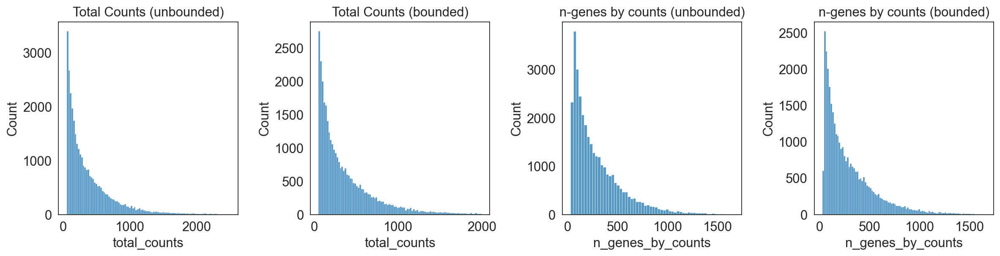

In [10]:
hist_bin_options = ['auto', 100, 60, 100]

plot_qc_hist(adata,
        total_counts_cutoff=2000,
        n_genes_high_cutoff=2000, 
        n_genes_low_cutoff= 0,
        bin_options = hist_bin_options)

### Visualize the position of cells using a scatter plot
For slideseq_v2, we customize the plot with a puck_center 

{'fig_size': (4, 4), 's': 0.2, 'c1': 'red', 'c2': 'slateblue', 'label1': 'Cells Removed', 'label2': 'Cells Filtered', 'add_circle': True, 'puck_center': (3330, 3180), 'puck_radius': 2550}


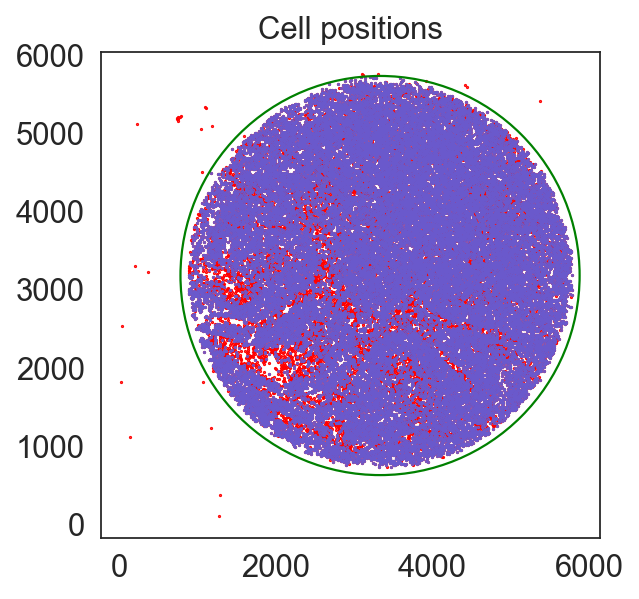

In [11]:
# Filter out beads outside the puck
puck_center = (3330,3180) # (x,y)
puck_radius = 2550
puck_mask = np.sqrt((adata.obs["ycoord"] - puck_center[1])**2 + (adata.obs["xcoord"] - puck_center[0])**2) < puck_radius
adata = adata[puck_mask,:]

# Visualize cell positions in puck
plot_cell_positions(adata,
            raw_x,
            raw_y,
            coord_keys=coord_keys,
            fig_size = (4,4),
            add_circle=True,
            puck_center=puck_center,
            puck_radius=puck_radius)

## Normalize / Filter highly variable genes (HVG)

### Normalize Total
We first normalize the raw annadata object using `scanpy`'s `normalize_total`


In [12]:
from utils.filter_utils import *

# Normalizes the anndata dataset
adata = normalize_total(adata)

--- Max-Min before normalization -----
Displaying max and min of Dataset
Max: 455.0, Min: 0.0

--- Max-Min after normalization -----
Displaying max and min of Dataset
Max: 144.720947265625, Min: 0.0



### We can then filter by Highly Variable Genes (HVG) using a specified threshold

We use the **raw count data** (flavor = `"seurat_v3"`) or **log-transformed data** (flavor = `"seurat"`)

In [13]:
### NOTE, I only used the top 100 genes because my PC is not powerful enough (it crashes as the matrix gets too large)
### please use `n_top_genes=2000`

adata, adata_allgenes = filter_hvg(adata,
            n_top_genes=2000,
            flavor="seurat")

--- Normalized and log-transformed data -----
Displaying max and min of Dataset
Max: 4.981693267822266, Min: 0.0

Displaying dataset after filtering by HVG


View of AnnData object with n_obs × n_vars = 33278 × 2000
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    obsm: 'coord_xy'

### Check genes and cells annotations

Display attribute of the filtered data after filtering steps and HVG analysis

In [14]:
display_adata(adata)

Displaying adata Object and their attributes
Adata attributes and dimensions:


View of AnnData object with n_obs × n_vars = 33278 × 2000
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    obsm: 'coord_xy'

Matrix sparsity: 1133730 filled elements (0.02) out of 66556000
max: 144.720947265625, min: 0.1017628163099289

Displaying observations (adata.obs)


,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_counts
barcodes,,,,,,,,,,,,,,
CTTCCATGACATTT,2892.276596,3060.489362,188,5.241747,245.0,5.505332,43.673469,64.081633,100.000000,100.000000,0.0,0.0,0.0,245.0
TAGCCGGGTCTCTG,5459.803030,4279.257576,143,4.969813,160.0,5.081404,41.875000,73.125000,100.000000,100.000000,0.0,0.0,0.0,160.0
GCCTTGCTGAGCTC,1632.575000,3463.375000,539,6.291569,702.0,6.555357,26.353276,37.464387,51.709402,94.444444,0.0,0.0,0.0,702.0
AGATACCAAGCCTT,3718.147059,3273.235294,364,5.899897,441.0,6.091310,28.798186,40.136054,62.811791,100.000000,0.0,0.0,0.0,441.0
TGAAACGTGTCATT,3733.886364,5466.000000,1028,6.936343,1499.0,7.313221,22.615077,30.887258,44.229486,64.776518,0.0,0.0,0.0,1499.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTTTCAAGAAACA,4340.000000,3312.261364,101,4.624973,106.0,4.672829,51.886792,99.056604,100.000000,100.000000,0.0,0.0,0.0,106.0
AGGGTAACGAAAAC,5016.590909,2432.984848,130,4.875197,141.0,4.955827,43.262411,78.723404,100.000000,100.000000,0.0,0.0,0.0,141.0
TTGCCCGTCAAACA,4602.906977,3682.116279,147,4.997212,197.0,5.288267,50.761421,76.142132,100.000000,100.000000,0.0,0.0,0.0,197.0


Displaying variables (adata.var)


,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells
Row,,,,,,,,
0610043K17Rik,False,219,0.006102,0.006083,99.445513,241.0,5.488938,212
1110015O18Rik,False,17,0.000430,0.000430,99.956958,17.0,2.890372,15
1110018N20Rik,False,24,0.000608,0.000607,99.939234,24.0,3.218876,23
1110019D14Rik,False,197,0.005671,0.005655,99.501215,224.0,5.416101,192
1110025M09Rik,False,26,0.000760,0.000759,99.934171,30.0,3.433987,26
...,...,...,...,...,...,...,...,...
mt-Tm,False,335,0.008558,0.008521,99.151813,338.0,5.826000,318
mt-Tp,False,919,0.023926,0.023645,97.673182,945.0,6.852242,855
mt-Tq,False,127,0.003241,0.003236,99.678448,128.0,4.859812,124


## Generate spatial weights graph

#### In BANKSY, we imagine edges / connections in the graph to represent neighbour relationships between cells

In doing so, the banksy algorithm requires the following specifications

1. The number of neighbours `num_neighbours`
    
2. The spatial width for choosing neighbours, by default, we use gaussian decay from cell location with $\sigma$ = `sigma` and cutoff radius by `p_outside` of a normalized gaussian probablility distribution with the same `sigma`. This is set using the `nbr_weight_decay` parameter

3. The azumithal transformation parameter `max_m` which indicates the specified azimuthal transformation for the Gabor Filter up to the `max_m`-th order. By default, we set `max_m` = 1.
    
    
### Connections can be weighted in various ways

We imagine connections between nodes (represented by cells) in a graph to be unweighted. However, we attribute edges with a `weight` that is a function of the distance between cells
    
Weight of edges can be represented by uniform distance (i.e., a closer neighbour will have a higher weight), or using `reciprocal` ($\frac{1}{r})$. Banksy, by default, applies a `scaled_gaussian` function to map the distance (between nodes) to the `weights` the connection of cell-to-negihbor

In [15]:
from banksy.main import generate_spatial_weights_fixed_nbrs, median_dist_to_nearest_neighbour

# set params
# ==========
plot_graph_weights = True
num_neighbours = 15 # only for fixed type
max_m = 1 # azumithal transform up to kth order
nbr_weight_decay = "scaled_gaussian" # can also be "reciprocal", "uniform" or "ranked"

# Find median distance to closest neighbours
nbrs = median_dist_to_nearest_neighbour(adata, key = coord_keys[2])


Median distance to closest cell = 15.162166157785881



### Generate spatial weights from distance
Here, we generate the spatial weights using the gaussian decay function from the median distance to the k-th nearest negihbours as specified earlier

The utility functions `plot_edge_histograms`, `  plot_weights`, `plot_theta_graph` can be used to visualize the characteristics of the edges, weights and theta (from the AGF) respectively.

---- Ran generate_spatial_distance_graph in 0.36 s ----

---- Ran row_normalize in 0.20 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 2.36 s ----


Edge weights (distances between cells): median = 35.163551502701175, mode = 40.78742692499321

---- Ran plot_edge_histogram in 0.08 s ----


Edge weights (weights between cells): median = 0.058971382268315484, mode = 0.028720281769638027

---- Ran plot_edge_histogram in 0.09 s ----

---- Ran generate_spatial_distance_graph in 0.47 s ----

---- Ran theta_from_spatial_graph in 0.73 s ----

---- Ran row_normalize in 0.25 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 3.25 s ----


Edge weights (distances between cells): median = 50.306842426666094, mode = 55.27987914350394

---- Ran plot_edge_histogram in 0.10 s ----


Edge weights (weights between cells): median = (1.7346078067161852e-05+0.03950528866257916j), mode = (-0.012499224331284087+0.005672196197184838j)

---- Ran plot_edge_histogram in 0.30 s ----



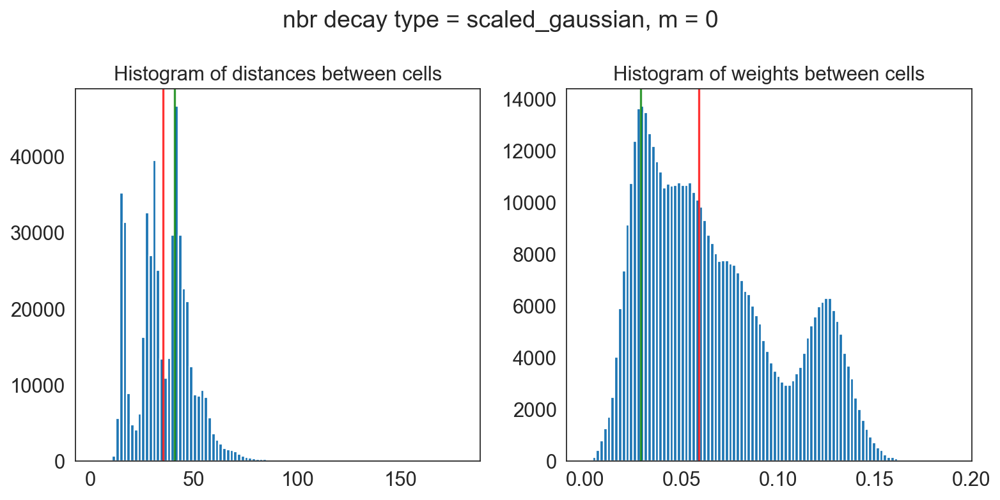

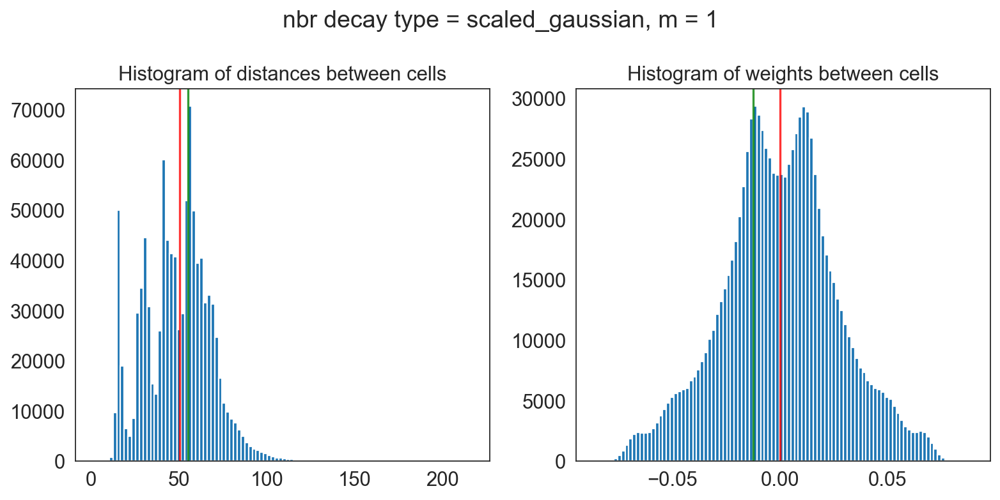

In [16]:
from utils.plot_utils import plot_edge_histograms, plot_weights, plot_theta_graph

processing_dict = {} # Dictionary containing all the information during runtime
     
weights_graphs = {} # Sub-dictionary containing weighted graph

for m in range(max_m+1):
    
    weights_graph, distance_graph, theta_graph = generate_spatial_weights_fixed_nbrs(
        adata.obsm[coord_keys[2]],
        m=m,
        num_neighbours=num_neighbours,
        decay_type=nbr_weight_decay,
        nbr_object=nbrs,
        verbose=False,
    )

    # Update weights_graph dictionary with key, value pair
    weights_graphs[m] = weights_graph
    
    # plot histograms of distances/weights between cells
    plot_edge_histograms(
        distance_graph=distance_graph,
        weights_graph=weights_graph,
        decay_type=nbr_weight_decay,
        m=m
    )

processing_dict[nbr_weight_decay] = {"weights": weights_graphs}

    
*optional*: **Visualize weights** by plotting the connections. Line thickness is proportional to edge weight (normalized by highest weight across all edges)

In [17]:
# plot_weights(
#     adata,
#     processing_dict,
#     nbr_weight_decay,
#     max_m,
#     fig_title= f'nbr decay type = {nbr_weight_decay}',
#     coord_keys=coord_keys)

---- Ran theta_from_spatial_graph in 0.70 s ----



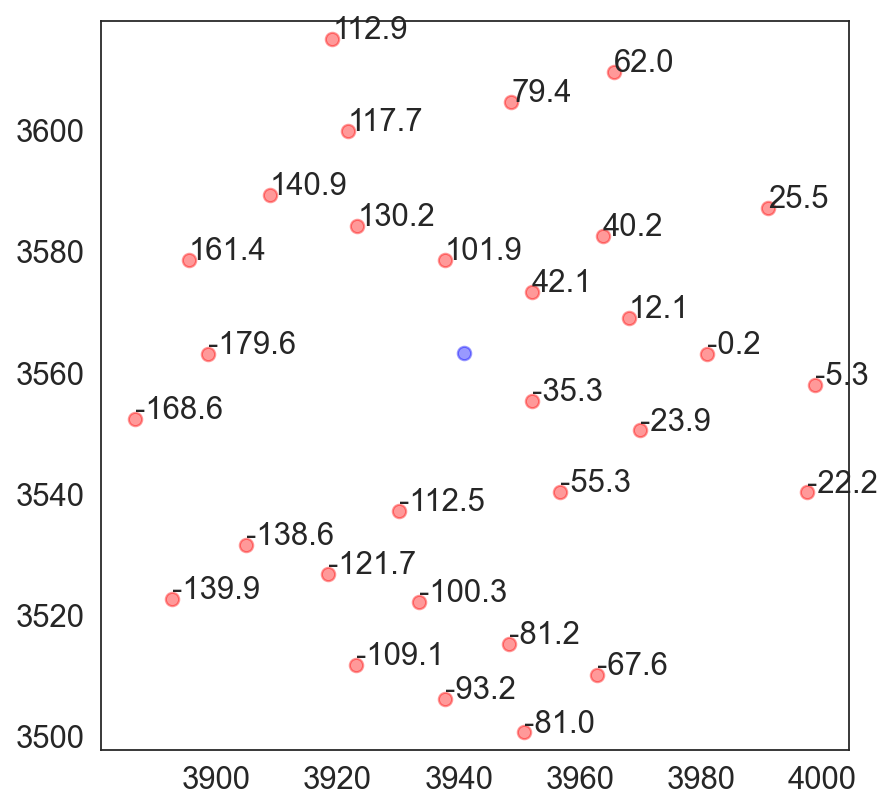

In [18]:
from banksy.main import theta_from_spatial_graph

theta_graph = theta_from_spatial_graph(adata.obsm["coord_xy"], distance_graph)

# Visualize the projections of a cell in its environment
plot_theta_graph(adata,theta_graph,coord_keys)

<i> (Optional) </i> Visualizing the azimuthal angles for as weights between nodes from the AGF

In [19]:
# To visualize weighted graph after AGF
plot_azimuthal = False
if plot_azimuthal:
    # Other options for formatting plots
    kwargs = {'max_weight': 2, 'markersize': 3, 'figsize': (15,8)}
    plot_weights(
        adata,
        processing_dict,
        nbr_weight_decay,
        max_m,
        fig_title=f'azimuthal angles',
        theta_graph=theta_graph,
        coord_keys=coord_keys,
        kwargs=kwargs)

## Generate BANKSY matrix

To generate the BANKSY matrix, we proceed with the following:

1. matrix multiply sparse CSR weights matrix with cell-gene matrix to get **neighbour matrix**
2. z-score both matrices along **genes**
3. multiply each matrix by a weighting factor $\lambda$ (`partition` in code)
4. concatenate the two matrices along the genes dimension

Here, we save all the results in the dictionary (`processing_dict`), which contains the results from the subsequent operations for BANKSY. 

In [20]:
from banksy.main import concatenate_all
from banksy.generate_banksy import create_banksy

# The following are the main hyperparameters for BANKSY
resolutions = [0.7,] # clustering resolution for UMAP
pca_dims = [20] # Dimensionality in which PCA reduces to
lambda_list = [0.2,] # list of lambda parameters

processing_dict, banksy_matrix = create_banksy(adata,
                                                processing_dict,
                                                lambda_list,
                                                max_m)

Runtime Jun-06-2023-22-38

2000 genes to be analysed:
Gene List:
Index(['0610043K17Rik', '1110015O18Rik', '1110018N20Rik', '1110019D14Rik',
       '1110025M09Rik', '1190005I06Rik', '1200014J11Rik', '1500009C09Rik',
       '1700001G11Rik', '1700001J03Rik',
       ...
       'mt-Rnr1', 'mt-Rnr2', 'mt-Tc', 'mt-Ti', 'mt-Tl1', 'mt-Tm', 'mt-Tp',
       'mt-Tq', 'mt-Ts2', 'mt-Tv'],
      dtype='object', name='Row', length=2000)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <33278x33278 sparse matrix of type '<class 'numpy.float64'>'
	with 499170 stored elements in Compressed Sparse Row format>, 1: <33278x33278 sparse matrix of type '<class 'numpy.complex128'>'
	with 998340 stored elements in Compressed Sparse Row format>}}

Cell by gene matrix has shape (33278, 2000)

Scale factors squared: [0.8        0.13333333 0.06666667], Scale factors: [0.89442719 0.36514837 0.25819889]
Shape of BANKSY matrix: (33278, 6000)
type of banksy_matrix: <class 'anndata._core.anndata.AnnData'>



### Show Z-score and save non-spatial results

In [21]:
print_max_min(adata)

# here, sigma = 0 and nbr-contributions are also 0, original adata is assigned here as well
processing_dict["nonspatial"] = {
    0.0: {"adata": concatenate_all([adata.X], 0, adata=adata), }
}

Displaying max and min of Dataset
Max: 144.720947265625, Min: 0.0

Scale factors squared: [1.], Scale factors: [1.]


## Reduce dimensions of each data matrix

1. We first use PCA implemenation from scikit-learn, which is implemented via `fit_transform`.
2. We then use the UMAP package for clustering.

### PCA to reduce dimensions (either auto-compute or set fixed dimensions to test)

Use PCA to reduce the number of dimensions from $2 * N_{genes}$ to desired number of dimensions `pca_dims`, by default, we reduce to 20 dimension

### UMAP to visualize reduced space

We use the UMAP package, with a set seed of 42

Current decay types: ['scaled_gaussian', 'nonspatial']

Reducing dims of dataset in (Index = scaled_gaussian, lambda = 0.2)

Original shape of matrix: (33278, 6000)
Reduced shape of matrix: (33278, 20)
------------------------------------------------------------
min_value = -108.56644439697266, max = 266.4407958984375

UMAP embedding
------------------------------------------------------------
shape: {umap_embedding.shape}


AxisArrays with keys: reduced_pc_20, reduced_pc_20_umap

Reducing dims of dataset in (Index = nonspatial, lambda = 0.0)

Original shape of matrix: (33278, 2000)
Reduced shape of matrix: (33278, 20)
------------------------------------------------------------
min_value = -87.78277587890625, max = 318.014892578125

UMAP embedding
------------------------------------------------------------
shape: {umap_embedding.shape}


AxisArrays with keys: reduced_pc_20, reduced_pc_20_umap


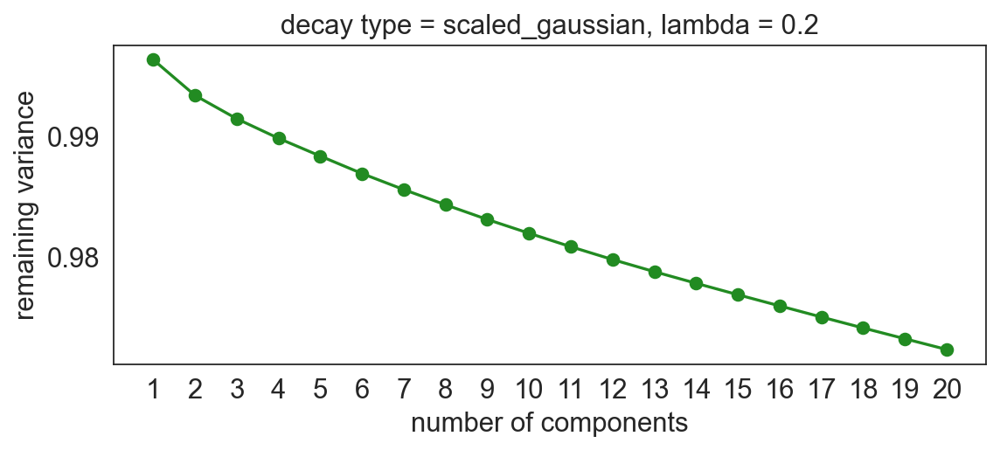

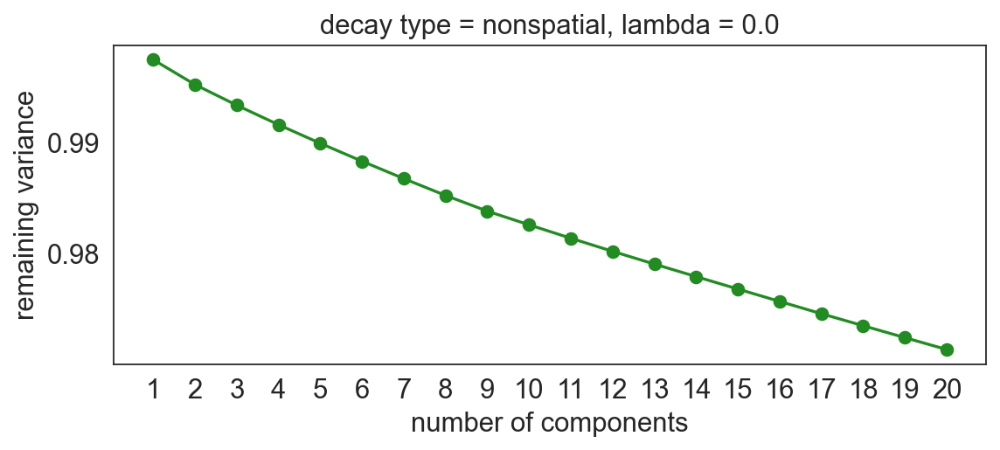

In [22]:
from utils.umap_pca import pca_umap

pca_umap(processing_dict,
         pca_dims=pca_dims)

### Create neighbours graph in the BANKSY space and partition

1. Create nearest neighbours graph in the BANKSY space. Set number of nearest neighbours using `num_banksy_nbrs`
    
2. Convert to shared nearest neighbours

3. Convert to igraph format for leidenalg package to work with

4. Do leiden clustering with ? partition method

In [23]:
from banksy.run_banksy import run_partition

results_df, max_num_labels = run_partition(
    processing_dict=processing_dict,
    resolutions=resolutions,
    num_nn = 50,
    num_iterations= -1,
    partition_seed= 1234,
    match_labels=True
)


Decay type: scaled_gaussian
Neighbourhood Contribution (Lambda Parameter): 0.2
reduced_pc_20 

reduced_pc_20_umap 

PCA dims to analyse: [20]

Setting up partitioner for (nbr decay = scaled_gaussian), Neighbourhood contribution = 0.2, PCA dimensions = 20)


Nearest-neighbour weighted graph (dtype: float64, shape: (33278, 33278)) has 1663900 nonzero entries.
---- Ran find_nn in 106.00 s ----


Nearest-neighbour connectivity graph (dtype: int16, shape: (33278, 33278)) has 1663900 nonzero entries.

(after computing shared NN)
Allowing nearest neighbours only reduced the number of shared NN from 33690632 to 1655835.


Shared nearest-neighbour (connections only) graph (dtype: int16, shape: (33278, 33278)) has 1530521 nonzero entries.

Shared nearest-neighbour (number of shared neighbours as weights) graph (dtype: int16, shape: (33278, 33278)) has 1530521 nonzero entries.

sNN graph data:
[12 25 14 ... 15 13  8]

---- Ran shared_nn in 11.62 s ----


-- Multiplying sNN connectivity by weights

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,relabeled
nonspatial_pc20_nc0.00_r0.70,nonspatial,0.0,20,0.7,16,"Label object:\nNumber of labels: 16, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 16, number of..."
scaled_gaussian_pc20_nc0.20_r0.70,scaled_gaussian,0.2,20,0.7,11,"Label object:\nNumber of labels: 11, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 11, number of..."


## Plot results

### Visualize the partitions done by BANKSY

number of labels: 16
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 16
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 16
---- Ran plot_2d_embeddings in 0.01 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((16, 33278) x (33278, 33278) x (33278, 16))

number of labels: 11
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 11
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 11
---- Ran plot_2d_embeddings in 0.01 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((11, 33278) x (33278, 33278) x (33278, 11))



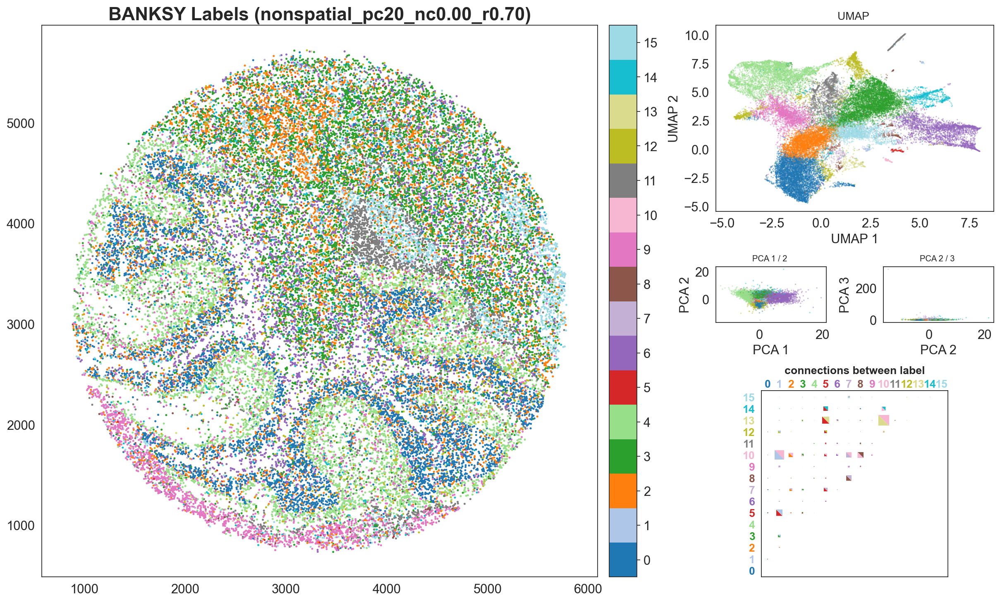

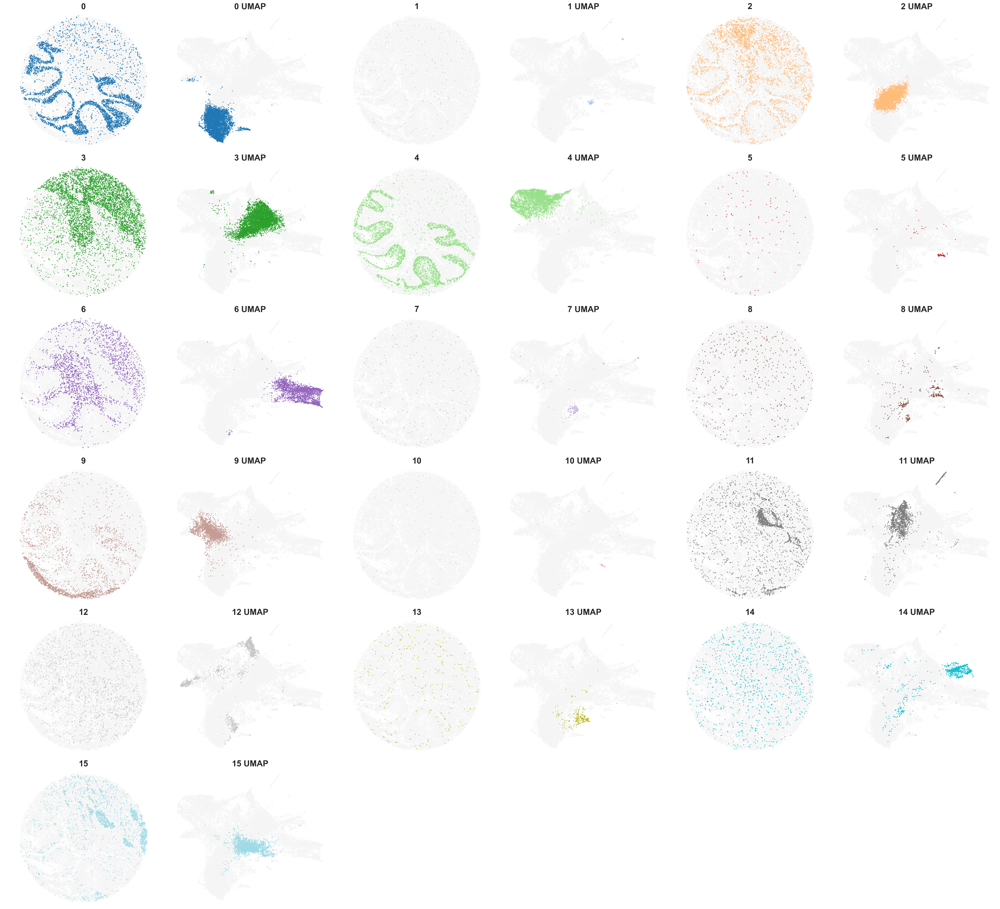

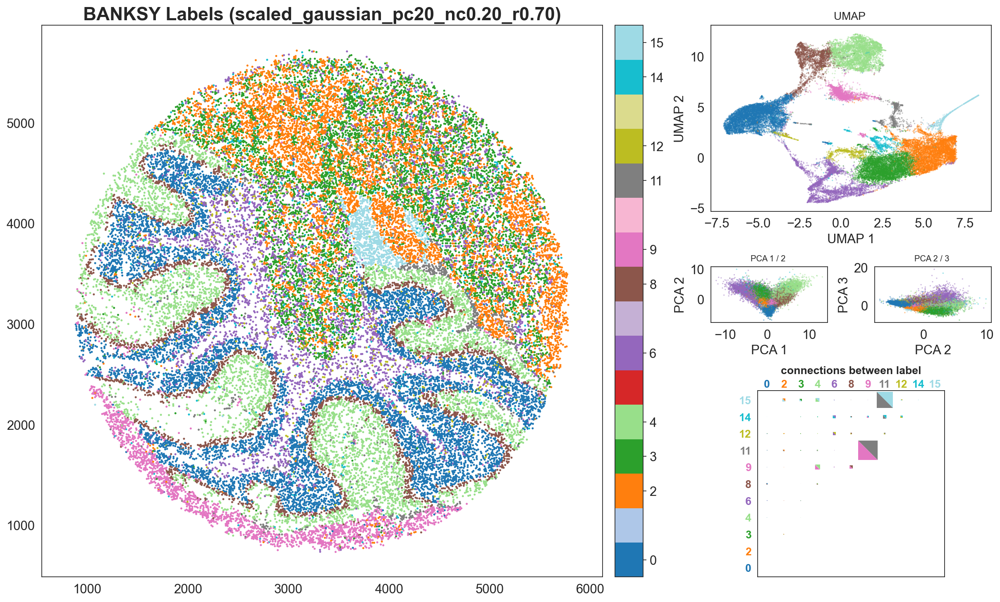

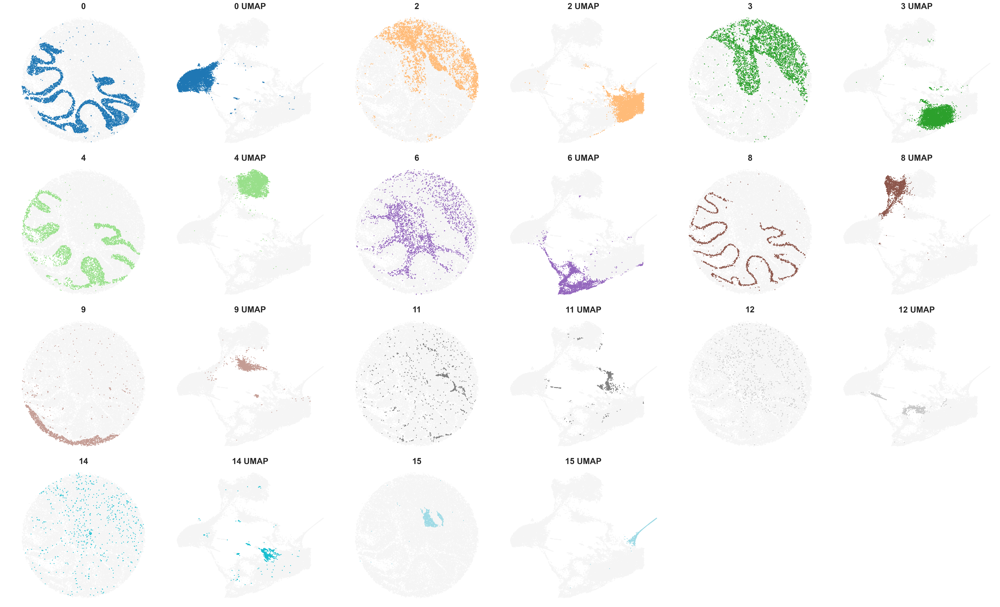

In [24]:
from banksy.plot_banksy import plot_results

c_map =  'tab20' # specify color map

plot_results(
    results_df,
    weights_graph,
    c_map,
    max_num_labels, 
    match_labels = True,
    filepath=file_path,
    coord_keys=coord_keys,
)

### Manually annotate clusters

#### Use a dictionary to map the cluster names

In [25]:
from utils.cluster_utils import pad_clusters, create_spatial_nonspatial_adata,  refine_cell_types

cluster2annotation_spatial = {
    "0" : "Granular Layer",
    "2" : "Interneurons and other Nnat",
    "3" : "Unknown 1",
    "4" : "Interneurons Pvalb",
    "6" : "Oligodendrocyte/Polydendrocyte",
    "8" : "Purkinje/Bergmann",
    "9" : "edge low quality",
    "11" : "Fibroblast-like Dcn", # and Microglia?
    "12" : "Astrocytes",
    "15" : "Choroid Plexus",
}

pad_clusters(cluster2annotation_spatial, list(range(max_num_labels)))

In [26]:
# Here, most clusters match so copy labels from spatial
cluster2annotation_nonspatial = cluster2annotation_spatial.copy()
cluster2annotation_nonspatial["4"] = "Purkinje/Bergmann" # note: looks like MLI but matches Purkinje reference better
cluster2annotation_nonspatial["8"] = "other"
cluster2annotation_nonspatial["11"] = "Choroid Plexus"
cluster2annotation_nonspatial["15"] = "other"

print(cluster2annotation_spatial,"\n", cluster2annotation_nonspatial)

# save annotations in two different anndata objects (adata_spatial and adata_nonspatial)

adata_spatial, adata_nonspatial = create_spatial_nonspatial_adata(results_df,
                                    pca_dims,
                                    lambda_list, 
                                    resolutions,
                                    cluster2annotation_spatial,
                                    cluster2annotation_nonspatial)

{'0': 'Granular Layer', '2': 'Interneurons and other Nnat', '3': 'Unknown 1', '4': 'Interneurons Pvalb', '6': 'Oligodendrocyte/Polydendrocyte', '8': 'Purkinje/Bergmann', '9': 'edge low quality', '11': 'Fibroblast-like Dcn', '12': 'Astrocytes', '15': 'Choroid Plexus', '1': 'other', '5': 'other', '7': 'other', '10': 'other', '13': 'other', '14': 'other'} 
 {'0': 'Granular Layer', '2': 'Interneurons and other Nnat', '3': 'Unknown 1', '4': 'Purkinje/Bergmann', '6': 'Oligodendrocyte/Polydendrocyte', '8': 'other', '9': 'edge low quality', '11': 'Choroid Plexus', '12': 'Astrocytes', '15': 'other', '1': 'other', '5': 'other', '7': 'other', '10': 'other', '13': 'other', '14': 'other'}
scaled_gaussian_pc20_nc0.20_r0.70
nonspatial_pc20_nc0.00_r0.70


### DE analysis of self genes (only) from BANKSY clustering

remove clusters not found in reference

In [27]:
from utils.plot_utils import plot_DE_genes, plot_DE_genes_refined, plot_connnection_grid, plot_clusters

cluster2annotation_refine = {
    "edge low quality" : "other",
    "Unknown 1" : "other",
}

adata_spatial_filtered, adata_nonspatial_filtered = refine_cell_types(adata_spatial, 
                                                                      adata_nonspatial,
                                                                      cluster2annotation_refine
                                                                      )

All refined cell types: Index(['Astrocytes', 'Choroid Plexus', 'Fibroblast-like Dcn', 'Granular Layer',
       'Interneurons Pvalb', 'Interneurons and other Nnat',
       'Oligodendrocyte/Polydendrocyte', 'Purkinje/Bergmann', 'other'],
      dtype='object')
[1. 1. 1. ... 1. 1. 1.] (33278, 33278)
[[    0.     0.     0.     0.     0.]
 [    0. 35512.  4402.   939.  2801.]
 [    0.  4184. 36489.  4128.  2863.]
 [    0.   961.  4692. 11403.  2088.]
 [    0.  2777.  2940.  2033. 10510.]]
[[       nan        nan        nan        nan        nan]
 [0.         1.         0.1239581  0.02644177 0.07887475]
 [0.         0.11466469 1.         0.11312998 0.078462  ]
 [0.         0.08427607 0.41147067 1.         0.18310971]
 [0.         0.26422455 0.27973359 0.19343482 1.        ]]
[1. 1. 1. ... 1. 1. 1.] (33278, 33278)
[[5.1431e+04 7.8250e+03 7.0600e+02 3.3300e+02 1.5200e+02]
 [6.6520e+03 1.9077e+04 6.4700e+03 3.5600e+02 3.6000e+01]
 [5.6200e+02 5.9990e+03 8.2004e+04 6.0260e+03 1.9000e+01]
 [3.3800

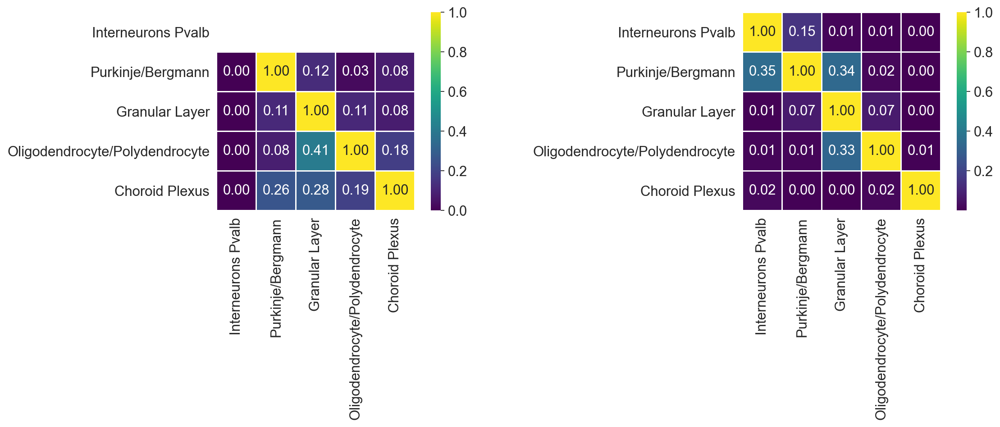

In [28]:
# cell_types = adata.obs["cell type refined"].cat.categories
cell_types = ["Interneurons Pvalb", 
              "Purkinje/Bergmann", 
              "Granular Layer",
              "Oligodendrocyte/Polydendrocyte",
              "Choroid Plexus"]

plot_connnection_grid(
    processing_dict,
    adata_nonspatial,
    adata_spatial,
    cell_types= cell_types,
    save_fig=False
)

## Plot DE genes of clusters from scRNAseq reference atlas

DE genes obtained from dropviz.org

In [29]:
# display(adata_allgenes)
print_max_min(adata_allgenes)

# z-score the unfiltered gene-cell matrix
# ---------------------------------------
sc.pp.scale(adata_allgenes)
# display(adata_allgenes)
print_max_min(adata_allgenes)

Displaying max and min of Dataset
Max: 144.720947265625, Min: 0.0

Displaying max and min of Dataset
Max: 179.2151336669922, Min: -1.0312352180480957



### Import RCTD weights
Optional: Plot each class

In [30]:
from utils.plot_utils import plot_continous_for_clusters, plot_markergene_sets

# load weights and locations (need to load locations because filtered seperately)
# load weights and locations (need to load locations because filtered seperately)
rctd_coord_filename = "slideseqv2_mc_coords_filtered.csv"
rctd_weights_filename = "slideseqv2_mc_RCTDweights.txt"
rctd_coord = pd.read_csv(os.path.join(file_path, rctd_coord_filename), index_col = 0)
rctd_weights = mmread(os.path.join(file_path, rctd_weights_filename)).todense()

# Optional
""" plot_continous_for_clusters(rctd_coord, rctd_weights) """

' plot_continous_for_clusters(rctd_coord, rctd_weights) '

### Get scRNA-seq reference marker genes and compute metagene

Marker genes are obtained from reference scRNA-seq dataset available at **dropviz.org**. 

DE genes are compared against rest of cerebellum with parameters (*default*):
 - Minimum Fold Ratio = 2
 - Minimum P-Value Exponenet = -100
 - Min Mean Log Amount in Target = 2.5
 - Max Mean Log amount in Comp = 1
 
Marker genes filtered out in preprocessing are not included.


In [31]:
# Metagene Dataframe
from utils.cluster_utils import create_metagene_df

metagene_df = create_metagene_df(adata_allgenes, coord_keys)
metagene_df.head()

Generating Metagene data...

16 DE markers for GranularNeuron_Gabra6
69 DE markers for PurkinjeNeuron_Pcp2
76 DE markers for Interneurons_Pvalb
26 DE markers for Interneurons_and_Other_Nnat
32 DE markers for Microglia_Macrophage_C1qb
1 scRNA-seq DE genes in Microglia_Macrophage_C1qb absent/filtered from slideseq dataset
85 DE markers for Oligodendrocyte_Polydendrocyte_Tfr_Tnr
161 DE markers for BergmannGlia_Gpr37l1
10 DE markers for Astrocyte_Gja1
43 DE markers for Choroid_Plexus_Ttr
211 DE markers for Endothelial_Flt1
7 scRNA-seq DE genes in Endothelial_Flt1 absent/filtered from slideseq dataset
105 DE markers for Fibroblast-Like_Dcn


,xcoord,ycoord,GranularNeuron_Gabra6,PurkinjeNeuron_Pcp2,Interneurons_Pvalb,Interneurons_and_Other_Nnat,Microglia_Macrophage_C1qb,Oligodendrocyte_Polydendrocyte_Tfr_Tnr,BergmannGlia_Gpr37l1,Astrocyte_Gja1,Choroid_Plexus_Ttr,Endothelial_Flt1,Fibroblast-Like_Dcn
barcodes,,,,,,,,,,,,,
CTTCCATGACATTT,2892.276596,3060.489362,-0.120264,-0.076469,-0.083812,-0.078164,-0.041621,-0.015354,-0.078325,1.859017,-0.042733,-0.039863,-0.040455
TAGCCGGGTCTCTG,5459.803030,4279.257576,-0.120264,-0.076469,-0.083812,-0.078164,-0.041621,-0.095174,-0.037510,-0.073798,-0.042733,-0.039863,-0.040455
GCCTTGCTGAGCTC,1632.575000,3463.375000,-0.120264,0.046232,0.007699,0.051791,-0.041621,0.070461,0.317107,-0.073798,-0.042733,0.004745,-0.040455
AGATACCAAGCCTT,3718.147059,3273.235294,-0.120264,0.014318,0.066653,0.074082,-0.041621,-0.095174,0.010231,-0.073798,-0.042733,-0.039863,-0.040455
TGAAACGTGTCATT,3733.886364,5466.000000,-0.120264,-0.032418,-0.012305,0.115045,0.023134,-0.074143,-0.001317,-0.073798,0.047840,0.030675,-0.001658


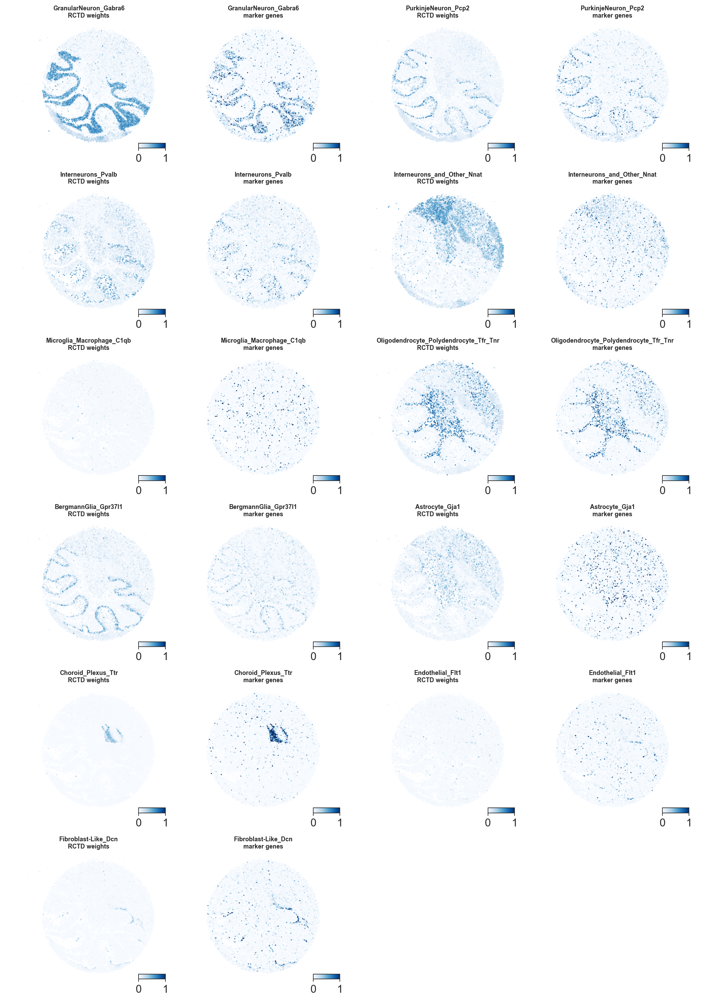

In [32]:
plot_markergene_sets(metagene_df,
                        rctd_coord, 
                        rctd_weights,
                        coord_keys,
                        save_fig=False)

### Comparison between spatial, nonspatial and RCTD weights


Generating 4 by 3 grid of plots (figsize = 12, 9.9)

16 scRNAseq DE markers for clusters ('GranularNeuron_Gabra6',)
10 scRNAseq DE markers for clusters ('Astrocyte_Gja1',)
43 scRNAseq DE markers for clusters ('Choroid_Plexus_Ttr',)


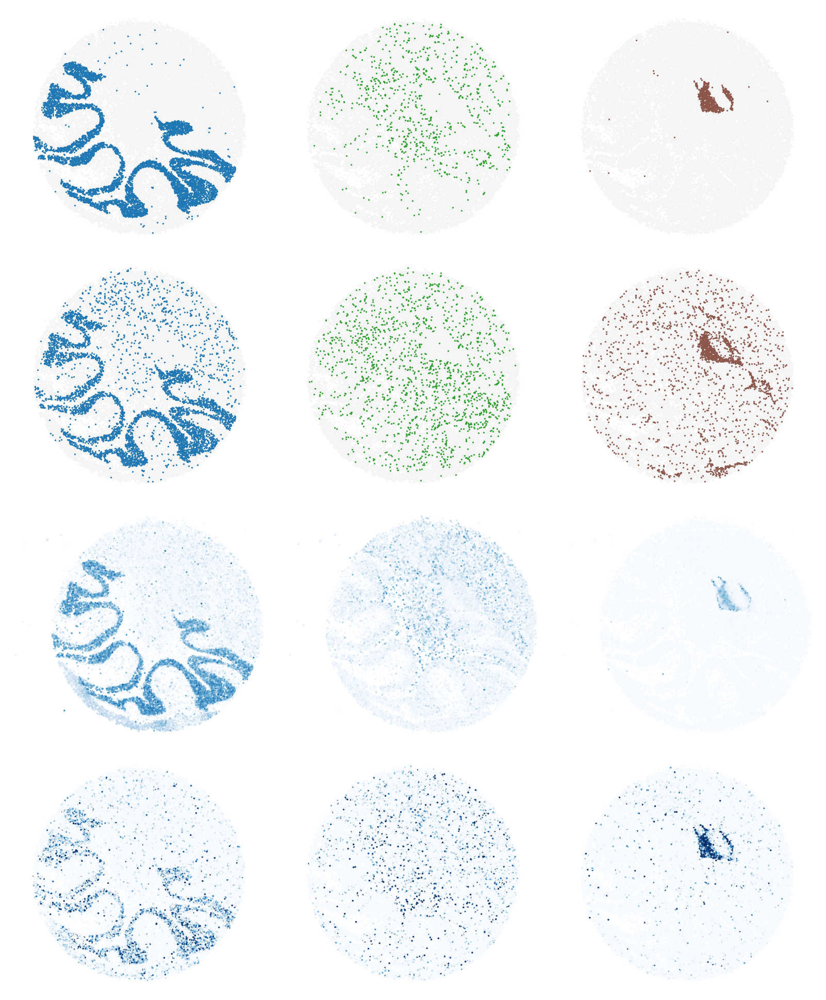

In [33]:
from utils.plot_utils import plot_weights_comparsion

# We use the layers args to indicate which layers to plot
# Here the layers are [nonspatial, spatial, RCTD, marker-genes]
layers1 = [
    [("Granular Layer", "Granular Layer"), 
     ("Granular Layer", "Granular Layer"),
     ("GranularNeuron_Gabra6",), 
     ("GranularNeuron_Gabra6",)
    ],
    [("Astrocytes",),
     ("Astrocytes",), 
     ("Astrocyte_Gja1",),
     ("Astrocyte_Gja1",)
    ],
    [("Choroid Plexus",),
     ("Choroid Plexus",), 
     ("Choroid_Plexus_Ttr",),
     ("Choroid_Plexus_Ttr",)
    ],
]

plot_weights_comparsion(adata_spatial,
                            adata_nonspatial,
                            adata_allgenes,
                            layers1,
                            rctd_coord,
                            rctd_weights,
                            save_fig=False,
                            file_path=file_path,
                            save_png_name="subplots_layers_sseqcerebellum_v2.png")

In [34]:
layers2 = [
    [("Purkinje/Bergmann",), 
     ("Purkinje/Bergmann",), 
     ("PurkinjeNeuron_Pcp2", "BergmannGlia_Gpr37l1"),
     ("PurkinjeNeuron_Pcp2", "BergmannGlia_Gpr37l1"),
    ],
    [("Interneurons Pvalb",),
     ("Interneurons Pvalb",), 
     ("Interneurons_Pvalb",),
     ("Interneurons_Pvalb",)
    ],
    [("Oligodendrocyte/Polydendrocyte"),
     ("Oligodendrocyte/Polydendrocyte"), 
     ("Oligodendrocyte_Polydendrocyte_Tfr_Tnr",),
     ("Oligodendrocyte_Polydendrocyte_Tfr_Tnr",)
    ],
    [("Fibroblast-like Dcn"),
     ("Fibroblast-like Dcn"), 
     ("Fibroblast-Like_Dcn",),
     ("Fibroblast-Like_Dcn",)
    ],
    [("Interneurons and other Nnat",),
     ("Interneurons and other Nnat",), 
     ("Interneurons_and_Other_Nnat",),
     ("Interneurons_and_Other_Nnat",)
    ],
]

# uncomment to plot cell types shown in supp fig ->

# plot_weights_comparsion(adata_spatial,
#                             adata_nonspatial,
#                             adata_allgenes,
#                             layers2,
#                             rctd_coord,
#                             rctd_weights,
#                             save_fig=False,
#                             file_path=file_path,
#                             save_eps_name="subplots_layers_sseqcerebellum_v2.eps")


### Compare major cell types to RCTD

Number of cells in both RCTD and adata: 27077
Comparing to RCTD
Comparing to Metagene


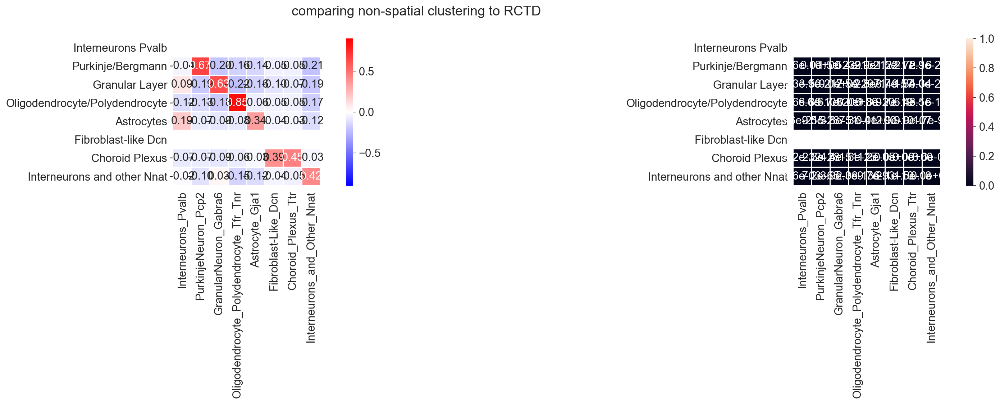

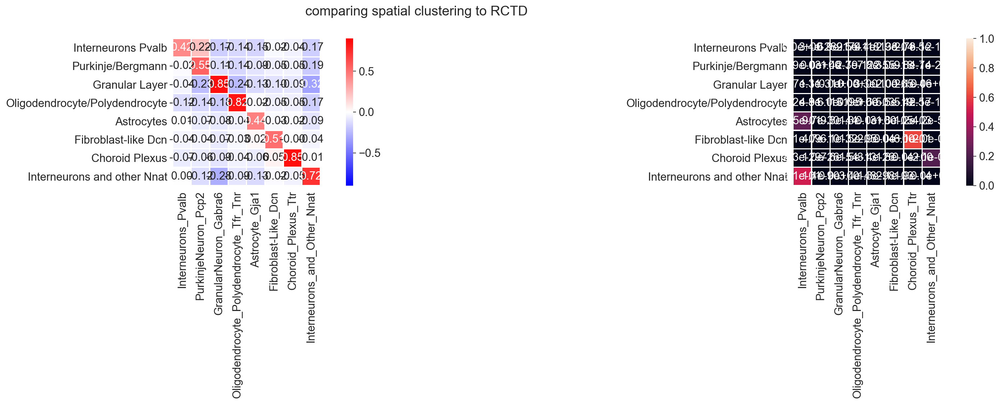

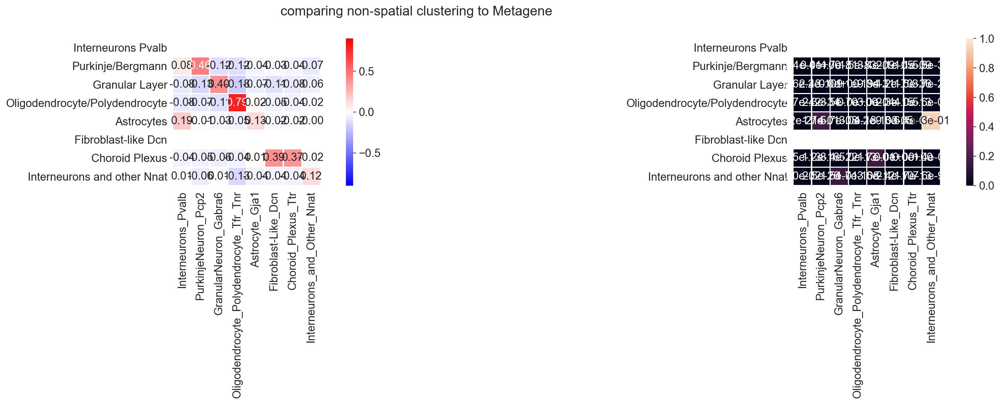

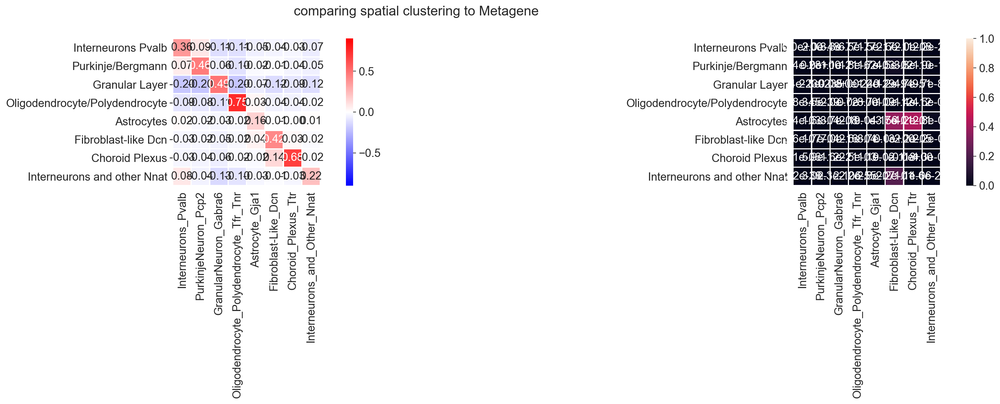

In [35]:
from utils.plot_utils import compare_weights

reference = [
    "Interneurons_Pvalb",
    "PurkinjeNeuron_Pcp2",
    "GranularNeuron_Gabra6",
    "Oligodendrocyte_Polydendrocyte_Tfr_Tnr",
    "Astrocyte_Gja1",
    "Fibroblast-Like_Dcn",
    "Choroid_Plexus_Ttr",
    "Interneurons_and_Other_Nnat",    
]

cell_types = [
    "Interneurons Pvalb",
    "Purkinje/Bergmann",
    "Granular Layer",
    "Oligodendrocyte/Polydendrocyte",
    "Astrocytes",
    "Fibroblast-like Dcn",
    "Choroid Plexus",
    "Interneurons and other Nnat",
]

compare_weights(
    adata_spatial,
    adata_nonspatial,
    metagene_df,
    rctd_coord,
    rctd_weights,
    cell_types,
    reference,
    save_fig = False)